In [1]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader , Dataset
import torchvision 
import torchvision.transforms as transforms
from tqdm import tqdm
import matplotlib.pyplot as plt
import torch.nn.functional as F

# Parameters Section 

In [12]:
batch_size = 64
input_dims = 100
epochs = 1000
device = torch.device("cuda:7" if torch.cuda.is_available() else "cpu")

# Data and Dataloader preparing section

In [13]:
TRANSFORM_IMG = transforms.Compose([
    transforms.Resize((128  , 128)),
    transforms.ToTensor(),
    transforms.Normalize((0.5 , 0.5 , 0.5) , (0.5 , 0.5 , 0.5))
    ])
dataset = torchvision.datasets.ImageFolder("./dataset/animals" ,transform=TRANSFORM_IMG)

dataloader = DataLoader(dataset, batch_size= batch_size, shuffle=True, num_workers=4)


# Model definition

In [14]:
class Generator(nn.Module):
    def __init__(self, input_dims):
        super(Generator, self).__init__()

        self.input_dims = input_dims
        self.input_layer = nn.Linear(input_dims, 4 * 4 * 1024)
        
        self.conv1T = nn.ConvTranspose2d(1024, 512, kernel_size=(5, 5), stride=2, padding=2, output_padding=1)
        self.norm1 = nn.BatchNorm2d(512)

        self.conv2T = nn.ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=2, padding=2, output_padding=1)
        self.norm2 = nn.BatchNorm2d(256)

        self.conv3T = nn.ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=2, padding=2, output_padding=1)
        self.norm3 = nn.BatchNorm2d(128)

        self.conv4T = nn.ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=2, padding=2, output_padding=1)
        self.norm4 = nn.BatchNorm2d(64)

        self.conv5T = nn.ConvTranspose2d(64, 3, kernel_size=(5, 5), stride=2, padding=2, output_padding=1)

        self.relu = nn.LeakyReLU(0.2, inplace=True)

    def forward(self, x):
        x = self.input_layer(x)
        x = x.view(x.size(0), 1024, 4, 4)  # Reshape for ConvTranspose layers

        x = self.relu(self.norm1(self.conv1T(x)))
        x = self.relu(self.norm2(self.conv2T(x)))
        x = self.relu(self.norm3(self.conv3T(x)))
        x = self.relu(self.norm4(self.conv4T(x)))
        x = torch.tanh(self.conv5T(x))  # Output should be in range [-1, 1]

        return x
    
    
class Critic(nn.Module):
    def __init__(self, output_dims):
        super(Critic, self).__init__()

        self.conv1 = nn.Conv2d(3, 64, kernel_size=(5, 5), stride=2, padding=2)
        self.norm1 = nn.BatchNorm2d(64)

        self.conv2 = nn.Conv2d(64, 128, kernel_size=(5, 5), stride=2, padding=2)
        self.norm2 = nn.BatchNorm2d(128)

        self.conv3 = nn.Conv2d(128, 256, kernel_size=(5, 5), stride=2, padding=2)
        self.norm3 = nn.BatchNorm2d(256)

        self.conv4 = nn.Conv2d(256, 512, kernel_size=(5, 5), stride=2, padding=2)
        self.norm4 = nn.BatchNorm2d(512)

        self.conv5 = nn.Conv2d(512, 1024, kernel_size=(5, 5), stride=2, padding=2)
        self.norm5 = nn.BatchNorm2d(1024)
        self.relu = nn.LeakyReLU(0.2, inplace=True)

        # Using Spectral Normalization
        self.conv5 = nn.utils.spectral_norm(self.conv5)
        self.conv4 = nn.utils.spectral_norm(self.conv4)
        self.conv3 = nn.utils.spectral_norm(self.conv3)
        self.conv2 = nn.utils.spectral_norm(self.conv2)
        self.conv1 = nn.utils.spectral_norm(self.conv1)

        self.output_layer = nn.Linear(4 * 4 * 1024, output_dims)

    def forward(self, x):
        x = self.relu(self.norm1(self.conv1(x)))
        x = self.relu(self.norm2(self.conv2(x)))
        x = self.relu(self.norm3(self.conv3(x)))
        x = self.relu(self.norm4(self.conv4(x)))
        x = self.relu(self.norm5(self.conv5(x)))
        
        # Global Average Pooling
        x = x.view(x.size(0), -1)  # Flatten to (batch_size, features)
        return self.output_layer(x)


    

class DCGan(nn.Module):
    def __init__(self,input_dims =100, output_dims = 1):
        super(DCGan,self).__init__()
        self.gen = Generator(input_dims)
        self.critic = Critic(output_dims)
    def forward(self , latents , images):
        x = self.gen(latents)
        generated = self.critic(x)
        real = self.critic(images) 
        return real , generated
        




In [15]:
class DCTrainer():
    def __init__(self,model , dataloader , optim_gen , optim_critic  , epochs, device ,latent_dims, ngenerate = 5):
        self.model = model.to(device)
        self.dataloader = dataloader
        self.optim_gen = optim_gen 
        self.optim_critc = optim_critic
        self.epochs = epochs
        self.device = device
        self.ngenerate = ngenerate
        self.latent_dims = latent_dims
        self.mvn = torch.distributions.MultivariateNormal( torch.zeros(latent_dims)  , torch.eye(latent_dims) )
    
    
    def latent_sampler(self ,batch_size ):
        samples = self.mvn.sample((batch_size,))
        return samples
    
    def loss_W2(self , real_y, gen_y,):
        real = torch.mean(real_y)
        fake = torch.mean(gen_y)
        return (fake - real) , -fake
    

    def noramlize_weights(self ):
        for p in self.model.critic.parameters():
            p.data.clamp_(-0.01 ,0.01)


    def train_step(self) :
        total_loss_critic = 0
        total_loss_gen = 0
        for i , (data , _) in enumerate(self.dataloader):
            self.optim_critc.zero_grad()
            self.optim_gen.zero_grad()
            z = self.latent_sampler(data.shape[0]).to(device=self.device)
            gen_data = self.model.gen(z).detach()
            gen_y   = self.model.critic(gen_data) 
            real_y = self.model.critic(data.to(self.device))
            
            loss_critic , _ = self.loss_W2(real_y , gen_y)
            loss_critic.backward()
            self.optim_critc.step()
            self.noramlize_weights()
            if( i % 5 == 0):
                z = self.latent_sampler(data.shape[0]).to(device=self.device)
            
                gen_data = self.model.gen(z)
                gen_y = self.model.critic(gen_data)
                loss_gen = -torch.mean(gen_y)
                loss_gen.backward()
                self.optim_gen.step()
                total_loss_gen += loss_gen.item()
            total_loss_critic += loss_critic.item()
            
        return total_loss_critic/len(self.dataloader) , total_loss_gen/len(self.dataloader)
    

    def show(self):
        images = self.generate_images(10)
        images  = [images[i].permute(1,2,0).detach().cpu().numpy() for i in range(images.shape[0])]
        plt.figure(figsize=(15, 10))  # Adjust the size as needed

        # Loop through the images and display each one
        for i, image in enumerate(images):
            plt.subplot(2, 5, i + 1)  # Change '1, 5' to the desired grid layout
            plt.imshow((image * 255).astype(np.uint8))
            plt.axis('off')  # This hides the axis

        plt.show()

    def generate_images(self , number = 5):
        self.model.eval()
        with torch.no_grad():
            z = self.latent_sampler(number).to(device=self.device)
            images = self.model.gen(z)
            return images
        
    def train(self):
        for epoch in range(self.epochs):
            loss_critic , loss_gen = self.train_step()
            print(f"Epoch {epoch} Generator Loss {loss_gen} Critic loss {loss_critic}")
            if(epoch%10 == 0):
                torch.save(self.model , f"model{epoch}.pt")
                self.show()




# Instantiation

In [19]:

model = DCGan(input_dims , output_dims=1).to(device=device)
learning_rate = 1e-8

optim_critc = torch.optim.RMSprop(model.critic.parameters() , learning_rate)
optim_gen = torch.optim.RMSprop(model.gen.parameters() , learning_rate)



In [20]:
trainer = DCTrainer(model , dataloader , optim_critic=optim_critc, optim_gen=optim_gen , epochs=epochs , device = device , latent_dims=input_dims )

Epoch 0 Generator Loss 0.00042419001350508015 Critic loss -0.00034588884343119227


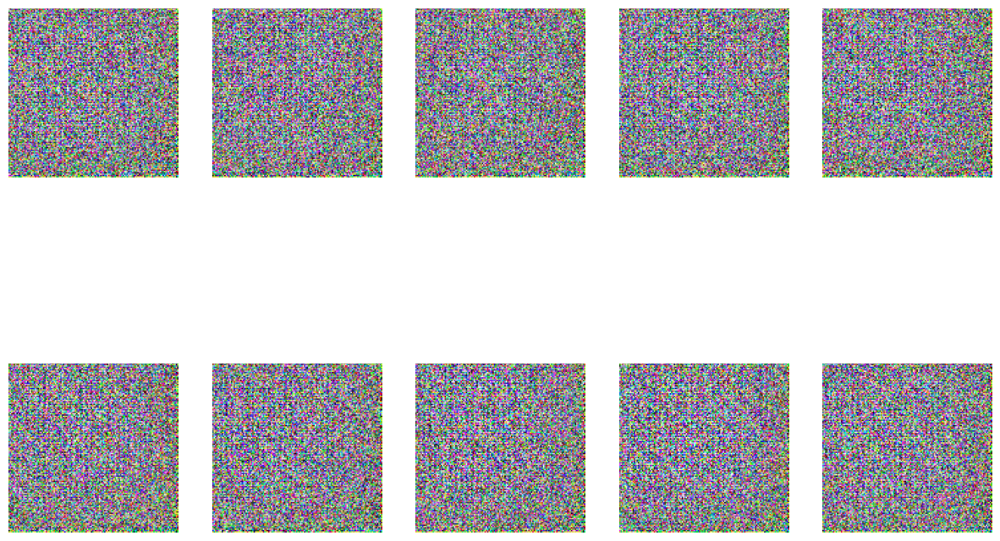

Epoch 1 Generator Loss 0.0005311394658158807 Critic loss -0.0005107921534491812
Epoch 2 Generator Loss 0.0006454180460423231 Critic loss -0.001341519529438194
Epoch 3 Generator Loss 0.0008299297160085509 Critic loss -0.002263439728823655
Epoch 4 Generator Loss 0.0009387717910987489 Critic loss -0.0032352896023760823
Epoch 5 Generator Loss 0.001075185725794119 Critic loss -0.0042431631235077105
Epoch 6 Generator Loss 0.0012825775836758754 Critic loss -0.0053038498825010135
Epoch 7 Generator Loss 0.0014459056615391199 Critic loss -0.006480030753814123
Epoch 8 Generator Loss 0.0016340740298961892 Critic loss -0.007670177108443835
Epoch 9 Generator Loss 0.0018245374783873558 Critic loss -0.008781527766190908
Epoch 10 Generator Loss 0.001994440419708981 Critic loss -0.009965201861718122


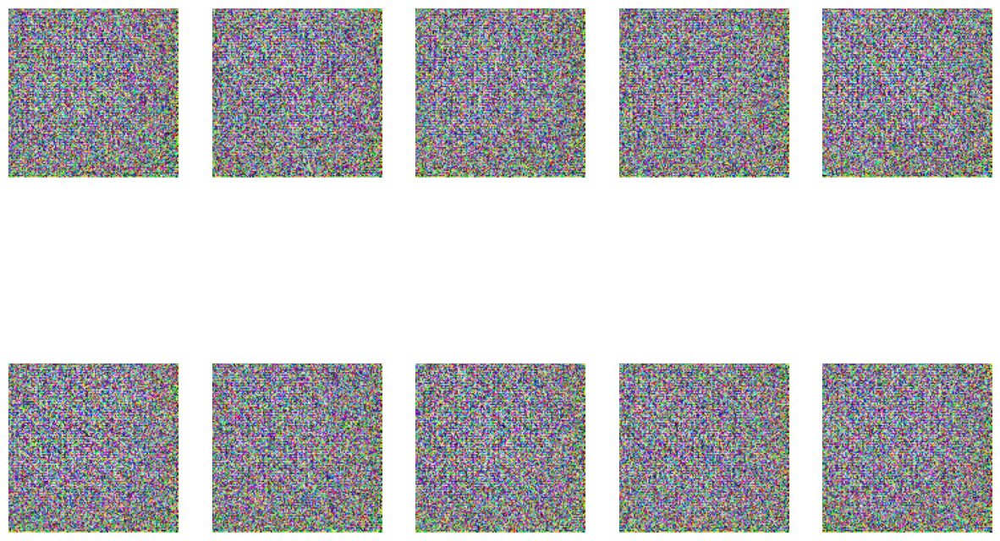

Epoch 11 Generator Loss 0.0021969888578442964 Critic loss -0.011074998525573927
Epoch 12 Generator Loss 0.0023328889380483065 Critic loss -0.012406431982184158
Epoch 13 Generator Loss 0.0025253455866785612 Critic loss -0.013555957541307982
Epoch 14 Generator Loss 0.0027612004648236666 Critic loss -0.014752854121958509
Epoch 15 Generator Loss 0.002967674263259944 Critic loss -0.015985625752193085
Epoch 16 Generator Loss 0.00310539066353265 Critic loss -0.017268349778126267
Epoch 17 Generator Loss 0.0033412744236343047 Critic loss -0.018521085008978845
Epoch 18 Generator Loss 0.0035913134979851107 Critic loss -0.019806858962949585
Epoch 19 Generator Loss 0.0037230910623774808 Critic loss -0.021088681457673803
Epoch 20 Generator Loss 0.003921281612094711 Critic loss -0.022278129484723595


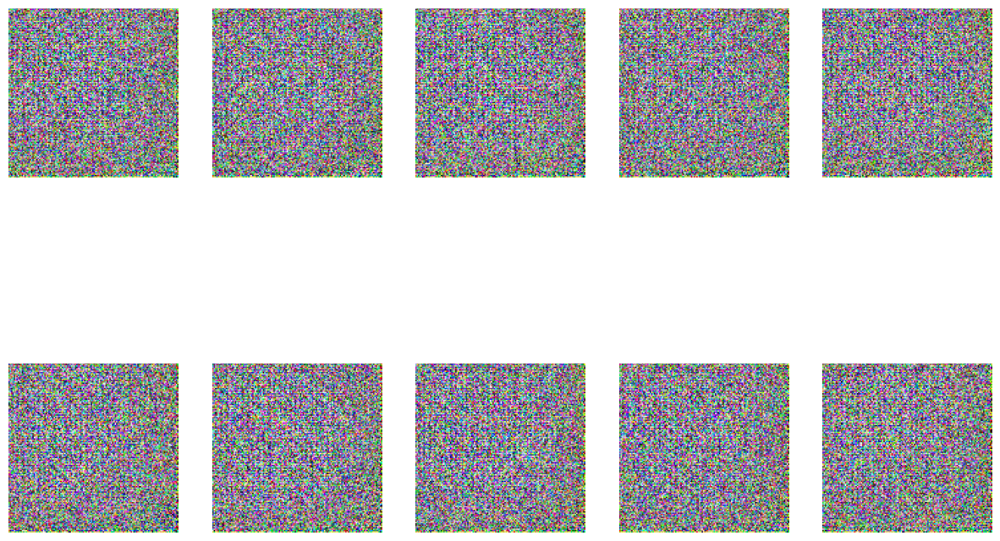

Epoch 21 Generator Loss 0.004189999511136728 Critic loss -0.02360658928313676
Epoch 22 Generator Loss 0.0043655767379438175 Critic loss -0.024887190255172113
Epoch 23 Generator Loss 0.004568427976439981 Critic loss -0.02628644362968557
Epoch 24 Generator Loss 0.004790247932952993 Critic loss -0.02754432758425965
Epoch 25 Generator Loss 0.005040838503662277 Critic loss -0.028927797188653664
Epoch 26 Generator Loss 0.0052401391241480326 Critic loss -0.030274918675422667
Epoch 27 Generator Loss 0.00544733823660542 Critic loss -0.03166623954825541
Epoch 28 Generator Loss 0.0056702075416550915 Critic loss -0.03307259628439651
Epoch 29 Generator Loss 0.005897277768920449 Critic loss -0.034483110554078045
Epoch 30 Generator Loss 0.006141061313888606 Critic loss -0.035887861690100505


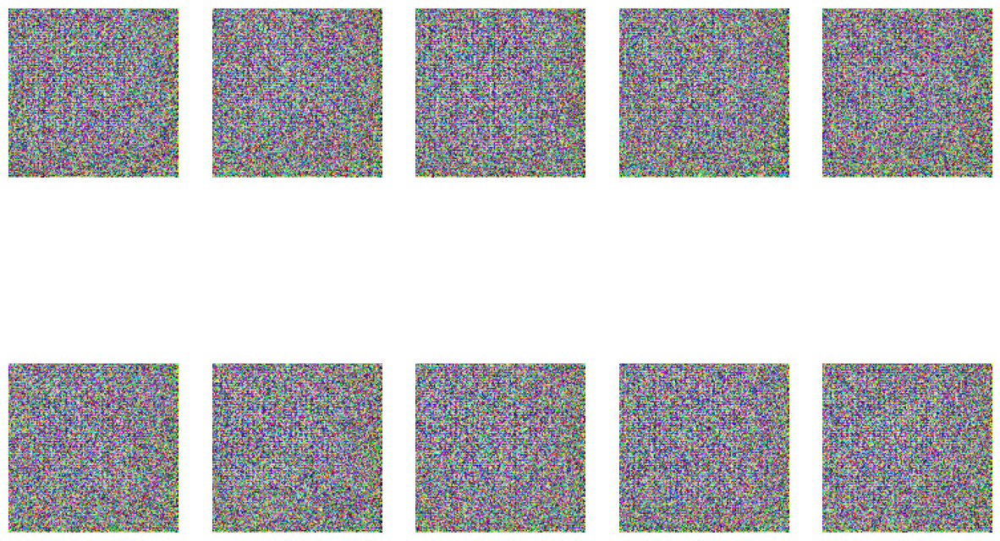

Epoch 31 Generator Loss 0.006303353432346793 Critic loss -0.037348723849829506
Epoch 32 Generator Loss 0.006565177572124144 Critic loss -0.03872871280593031
Epoch 33 Generator Loss 0.006833812199971255 Critic loss -0.04024098099154585
Epoch 34 Generator Loss 0.007061966727761661 Critic loss -0.04161534589879653
Epoch 35 Generator Loss 0.007291872799396515 Critic loss -0.04324448880027322
Epoch 36 Generator Loss 0.007534287563141655 Critic loss -0.04474089952076182
Epoch 37 Generator Loss 0.007856664806604385 Critic loss -0.0463407348622294
Epoch 38 Generator Loss 0.008081428443684298 Critic loss -0.047981235428768046
Epoch 39 Generator Loss 0.008363650344750461 Critic loss -0.04946410077459672
Epoch 40 Generator Loss 0.008582217772217357 Critic loss -0.05113413276917794


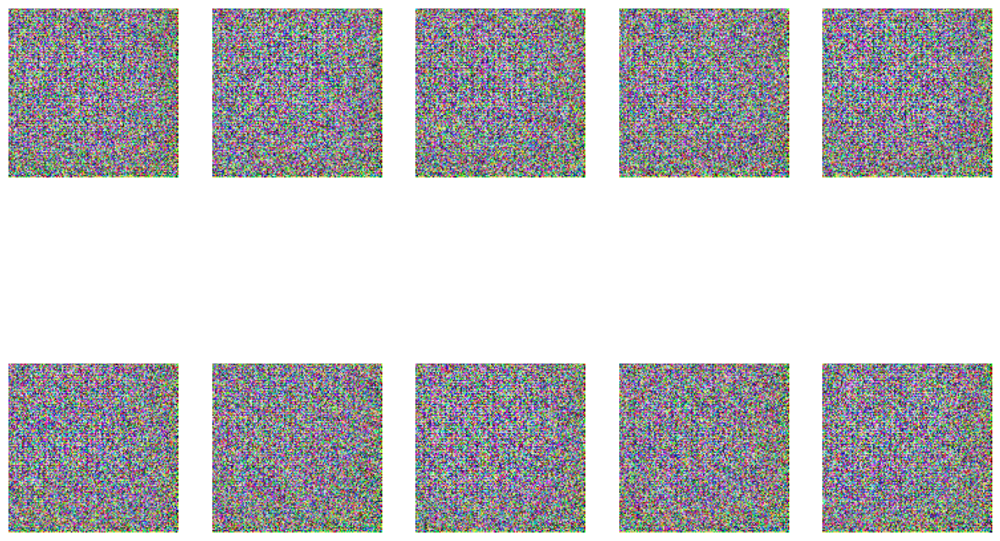

Epoch 41 Generator Loss 0.008886363839401919 Critic loss -0.05270649637369548
Epoch 42 Generator Loss 0.009086804486372892 Critic loss -0.05427365679951275
Epoch 43 Generator Loss 0.009424243209993138 Critic loss -0.056137041616089206
Epoch 44 Generator Loss 0.009656567038858638 Critic loss -0.057787498042863955
Epoch 45 Generator Loss 0.00998339683693998 Critic loss -0.05949858869699871
Epoch 46 Generator Loss 0.010259281756246791 Critic loss -0.06125833409674027
Epoch 47 Generator Loss 0.010562774276032168 Critic loss -0.0629702978712671
Epoch 48 Generator Loss 0.010845981888911303 Critic loss -0.06478574609055239
Epoch 49 Generator Loss 0.011139527576811173 Critic loss -0.06670133559142842
Epoch 50 Generator Loss 0.011455110285212011 Critic loss -0.06843790280468323


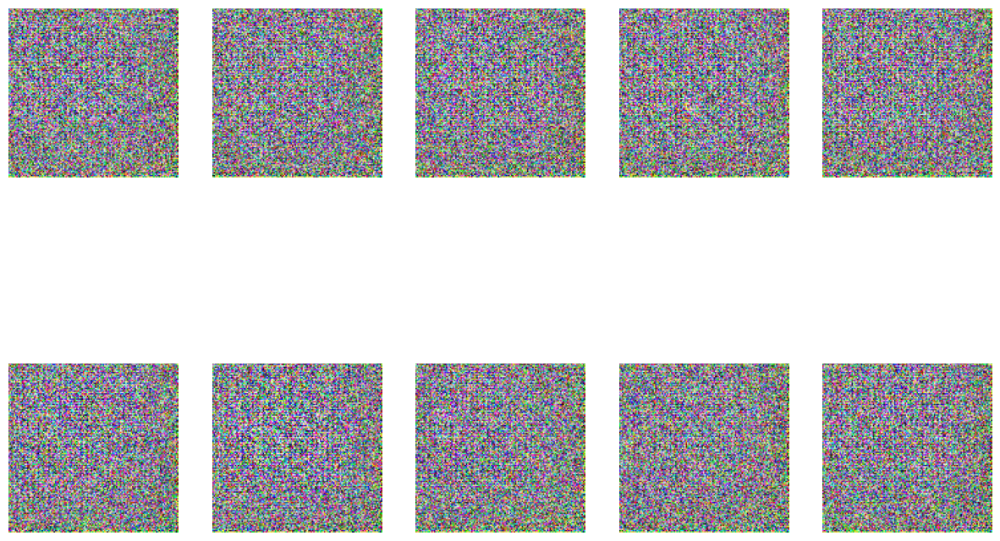

Epoch 51 Generator Loss 0.011765535131973379 Critic loss -0.07026511579751968
Epoch 52 Generator Loss 0.012069326902137084 Critic loss -0.07218588704572004
Epoch 53 Generator Loss 0.012387922581504373 Critic loss -0.07409606497077381
Epoch 54 Generator Loss 0.01275798507473048 Critic loss -0.07611983856734107
Epoch 55 Generator Loss 0.013066392435747035 Critic loss -0.07805332094430924
Epoch 56 Generator Loss 0.013439978483845205 Critic loss -0.08011617800768683
Epoch 57 Generator Loss 0.013677075066987206 Critic loss -0.08210159312276279
Epoch 58 Generator Loss 0.014090270154616412 Critic loss -0.08423340916633607
Epoch 59 Generator Loss 0.014380263843957115 Critic loss -0.08637478053569794
Epoch 60 Generator Loss 0.014753282070159912 Critic loss -0.088442442872945


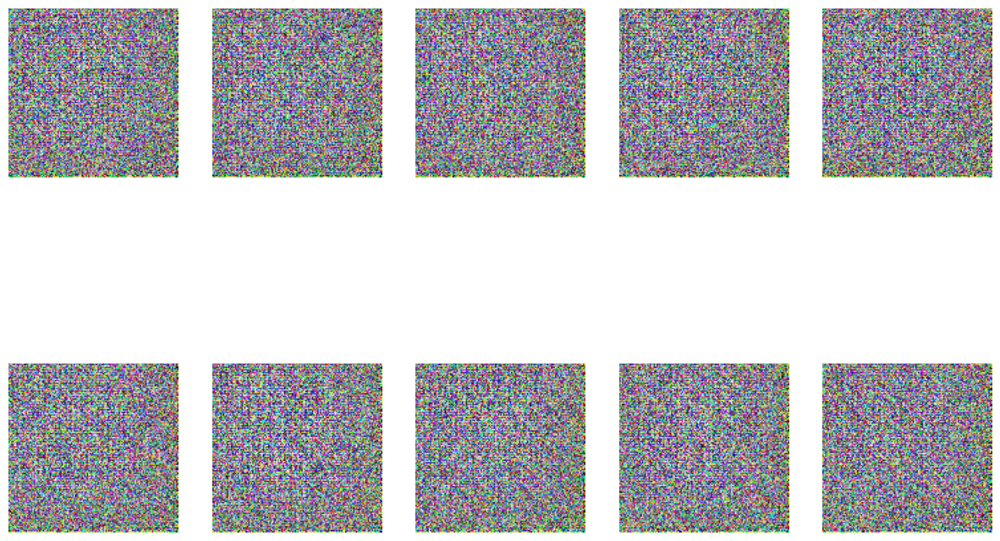

Epoch 61 Generator Loss 0.015099123295615701 Critic loss -0.09064831286668777
Epoch 62 Generator Loss 0.015497590689098133 Critic loss -0.09270441163988674
Epoch 63 Generator Loss 0.01587259243516361 Critic loss -0.09499334894558963
Epoch 64 Generator Loss 0.016233274954206803 Critic loss -0.0972417388768757
Epoch 65 Generator Loss 0.016632806202944588 Critic loss -0.0994983277776662
Epoch 66 Generator Loss 0.01705602319801555 Critic loss -0.10185038359726177
Epoch 67 Generator Loss 0.01749647435019998 Critic loss -0.10418735146522522
Epoch 68 Generator Loss 0.017769006946507623 Critic loss -0.10657029081793393
Epoch 69 Generator Loss 0.01821079333038891 Critic loss -0.10908200740814208
Epoch 70 Generator Loss 0.01865894294836942 Critic loss -0.1113826721906662


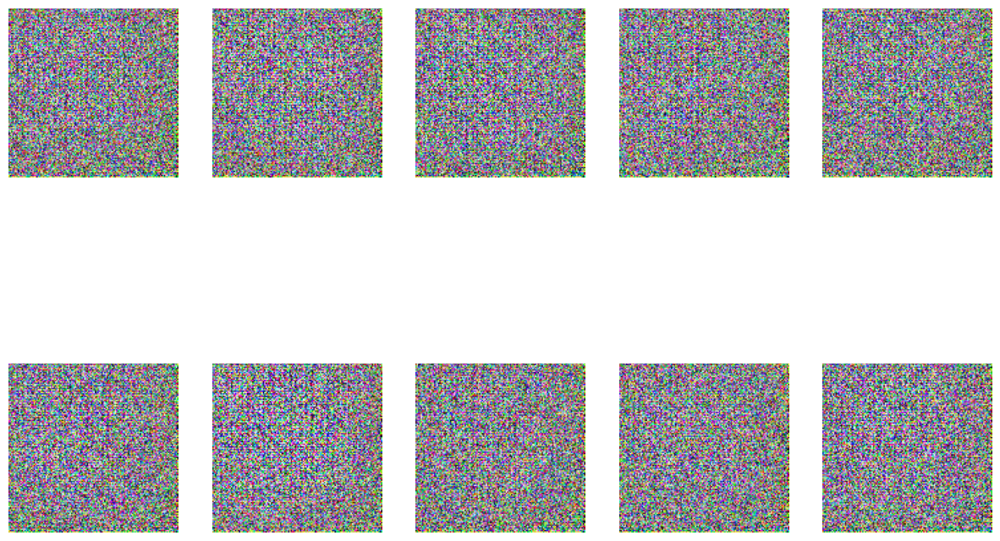

Epoch 71 Generator Loss 0.019103674415279836 Critic loss -0.11383690772687688
Epoch 72 Generator Loss 0.01953216817449121 Critic loss -0.11656371512833763
Epoch 73 Generator Loss 0.01994173789725584 Critic loss -0.11911435460343081
Epoch 74 Generator Loss 0.020407077144174016 Critic loss -0.12161400055184084
Epoch 75 Generator Loss 0.020782070826081668 Critic loss -0.1242884024977684
Epoch 76 Generator Loss 0.021245562504319585 Critic loss -0.12695966143818463
Epoch 77 Generator Loss 0.021805150806903838 Critic loss -0.12971446593018138
Epoch 78 Generator Loss 0.02215826642863891 Critic loss -0.13244673977879917
Epoch 79 Generator Loss 0.02265126941835179 Critic loss -0.1352509996470283
Epoch 80 Generator Loss 0.023144577706561368 Critic loss -0.13804503889644848


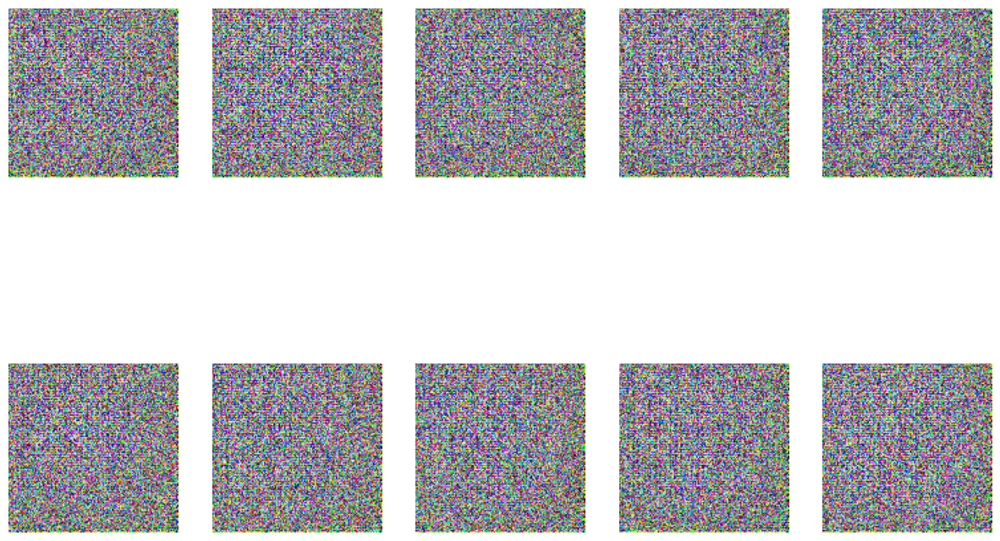

Epoch 81 Generator Loss 0.023588825499310212 Critic loss -0.1407646547345554
Epoch 82 Generator Loss 0.024082442066248724 Critic loss -0.14377813952810625
Epoch 83 Generator Loss 0.024551534214440514 Critic loss -0.14680578410625458
Epoch 84 Generator Loss 0.025093460871892816 Critic loss -0.14991961174151477
Epoch 85 Generator Loss 0.025734870398745818 Critic loss -0.15273764150984148
Epoch 86 Generator Loss 0.026150339841842653 Critic loss -0.15572468533235437
Epoch 87 Generator Loss 0.026831684217733496 Critic loss -0.15907003020539004
Epoch 88 Generator Loss 0.027212162403499378 Critic loss -0.1621263703879188
Epoch 89 Generator Loss 0.027836422008626602 Critic loss -0.1653860554975622
Epoch 90 Generator Loss 0.02844408838187947 Critic loss -0.16887407145079444


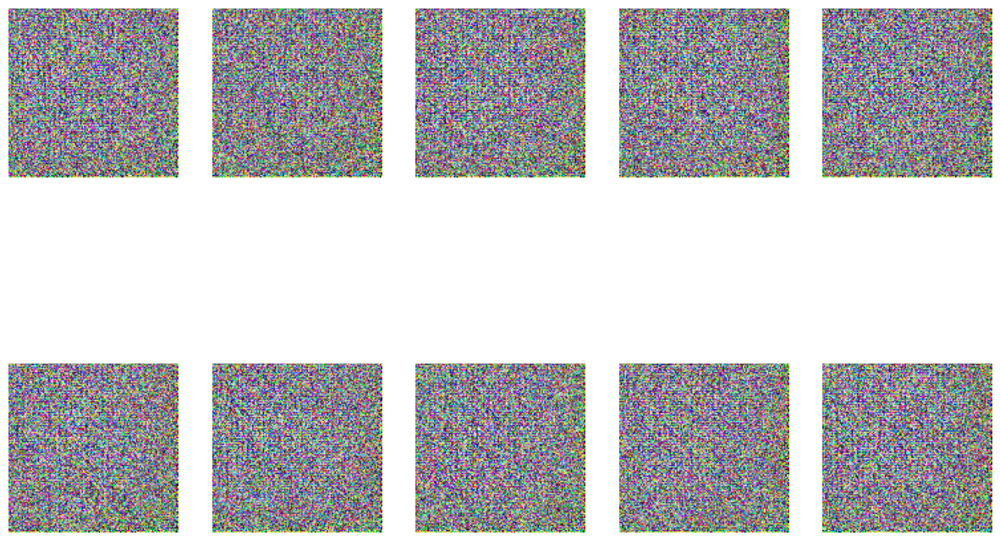

Epoch 91 Generator Loss 0.029007835949168486 Critic loss -0.17204612809069017
Epoch 92 Generator Loss 0.029572565941249622 Critic loss -0.1751814989482655
Epoch 93 Generator Loss 0.030034542083740234 Critic loss -0.1787594958263285
Epoch 94 Generator Loss 0.030707905573003434 Critic loss -0.18221907265046064
Epoch 95 Generator Loss 0.03129207544467028 Critic loss -0.1856929559918011
Epoch 96 Generator Loss 0.03201650223311256 Critic loss -0.1895489208838519
Epoch 97 Generator Loss 0.032638770341873166 Critic loss -0.19297508088981405
Epoch 98 Generator Loss 0.03306564530905555 Critic loss -0.19675641270244823
Epoch 99 Generator Loss 0.03382660290774177 Critic loss -0.20013493790346035
Epoch 100 Generator Loss 0.034643187768319074 Critic loss -0.20407164342263165


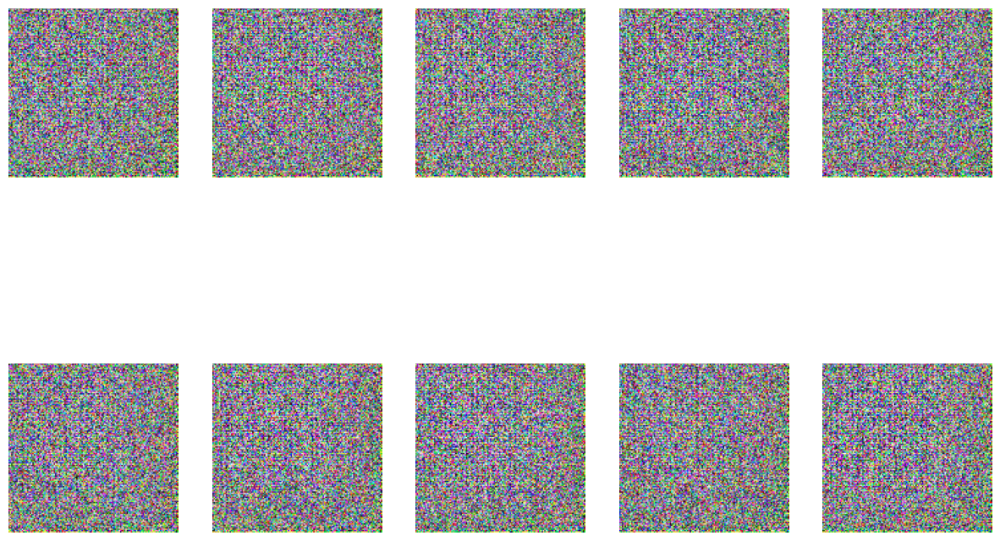

Epoch 101 Generator Loss 0.035138724306050466 Critic loss -0.2079748586696737
Epoch 102 Generator Loss 0.03586532876772039 Critic loss -0.2115626212428598
Epoch 103 Generator Loss 0.03642396769102882 Critic loss -0.21566094002302955
Epoch 104 Generator Loss 0.03718730369034935 Critic loss -0.22007088082678178
Epoch 105 Generator Loss 0.037923924537266 Critic loss -0.2236847747774685
Epoch 106 Generator Loss 0.03859171236262602 Critic loss -0.22809394177268533
Epoch 107 Generator Loss 0.03932303786277771 Critic loss -0.23196590122054606
Epoch 108 Generator Loss 0.040126634345335116 Critic loss -0.23632875470554127
Epoch 109 Generator Loss 0.04079903311589185 Critic loss -0.24065896658336414
Epoch 110 Generator Loss 0.04159215583520777 Critic loss -0.2449504135286107


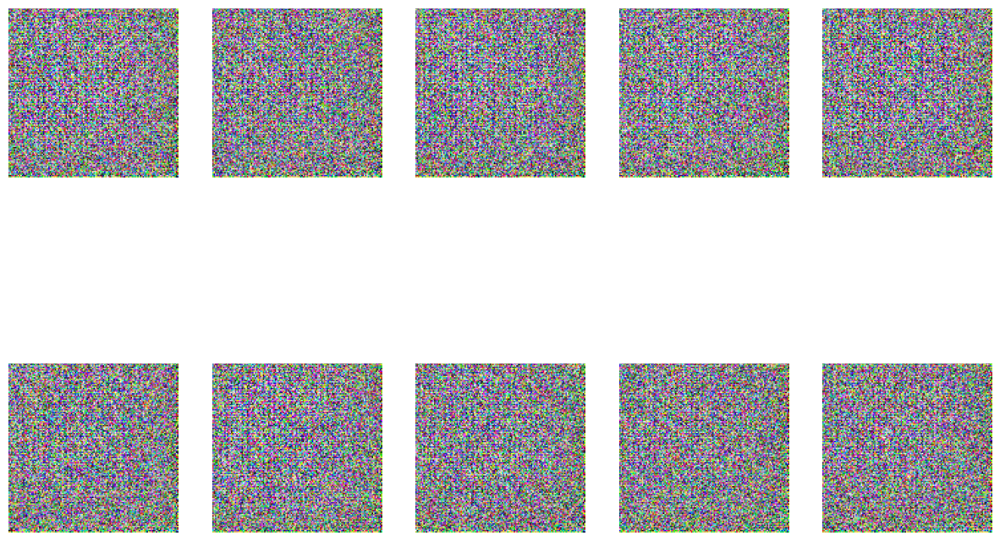

Epoch 111 Generator Loss 0.04230232010869419 Critic loss -0.24942889511585237
Epoch 112 Generator Loss 0.04309777424615972 Critic loss -0.2537778808790095
Epoch 113 Generator Loss 0.04398250176626093 Critic loss -0.2584899563999737
Epoch 114 Generator Loss 0.04467918259256026 Critic loss -0.26320655030362744
Epoch 115 Generator Loss 0.045466871647273796 Critic loss -0.26752497904440936
Epoch 116 Generator Loss 0.046339876686825474 Critic loss -0.27235481914351967
Epoch 117 Generator Loss 0.04704638404004714 Critic loss -0.27685766360339
Epoch 118 Generator Loss 0.0479666588937535 Critic loss -0.2816184853806215
Epoch 119 Generator Loss 0.04888615503030665 Critic loss -0.2864959471365985
Epoch 120 Generator Loss 0.049736371636390685 Critic loss -0.291977596282959


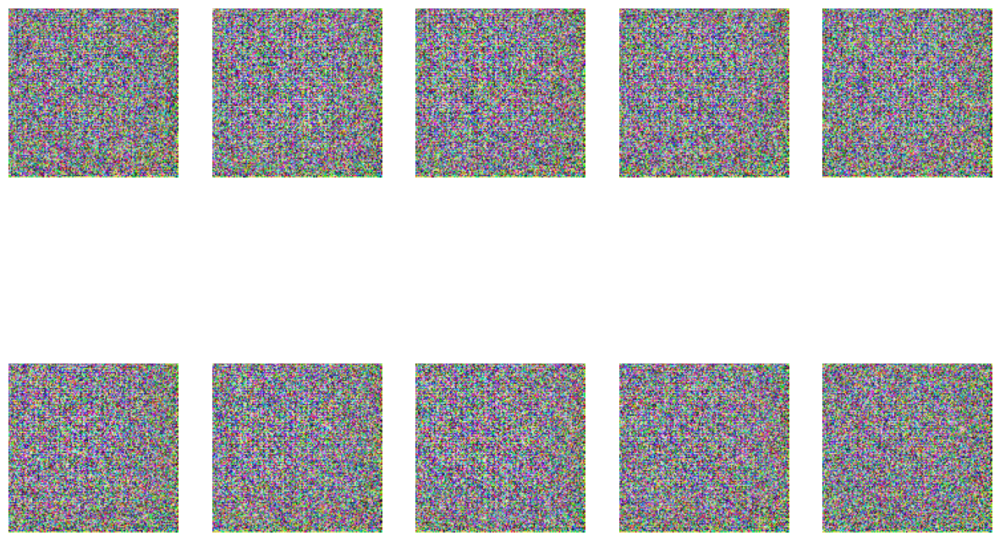

Epoch 121 Generator Loss 0.05049251896493575 Critic loss -0.2970642948851866
Epoch 122 Generator Loss 0.051589895346585445 Critic loss -0.30227638097370374
Epoch 123 Generator Loss 0.05229211659992442 Critic loss -0.307055045226041
Epoch 124 Generator Loss 0.05333282947540283 Critic loss -0.3125249974867877
Epoch 125 Generator Loss 0.05427561437382417 Critic loss -0.3178690468563753
Epoch 126 Generator Loss 0.05518135849167319 Critic loss -0.3229874056928298
Epoch 127 Generator Loss 0.056148240846746106 Critic loss -0.328981757514617
Epoch 128 Generator Loss 0.05718665999524734 Critic loss -0.3338842823224909
Epoch 129 Generator Loss 0.05814040548661176 Critic loss -0.33966998668277965
Epoch 130 Generator Loss 0.05932422280311585 Critic loss -0.3457537489778855


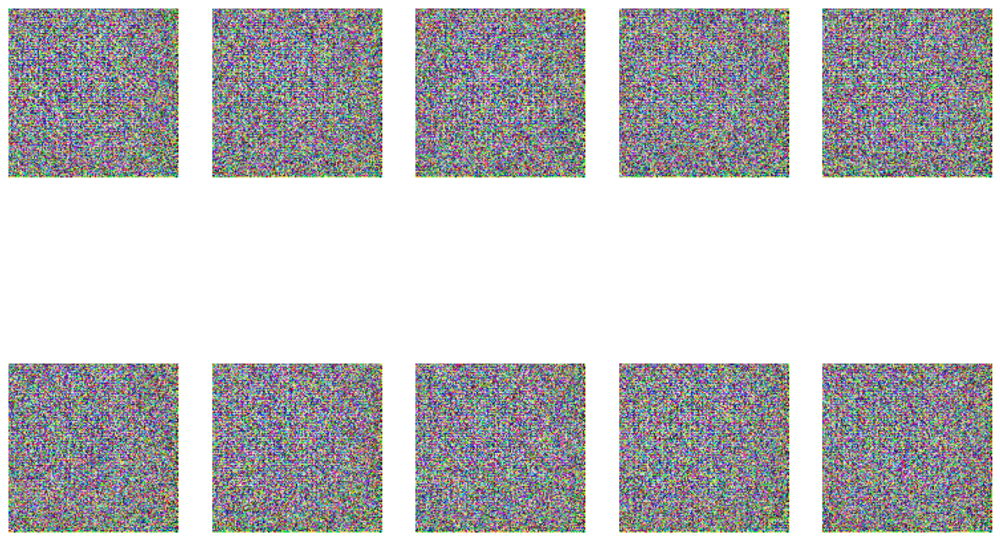

Epoch 131 Generator Loss 0.06020685259033652 Critic loss -0.35158745050430296
Epoch 132 Generator Loss 0.06122392030323253 Critic loss -0.35664136550005743
Epoch 133 Generator Loss 0.062221450665417836 Critic loss -0.3630186971496133
Epoch 134 Generator Loss 0.06319799002479104 Critic loss -0.36921069201301127
Epoch 135 Generator Loss 0.06437595451579374 Critic loss -0.37528520156355466


In [21]:
trainer.train()

/tmp/ipykernel_1309221/501369242.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load("model990.pt")


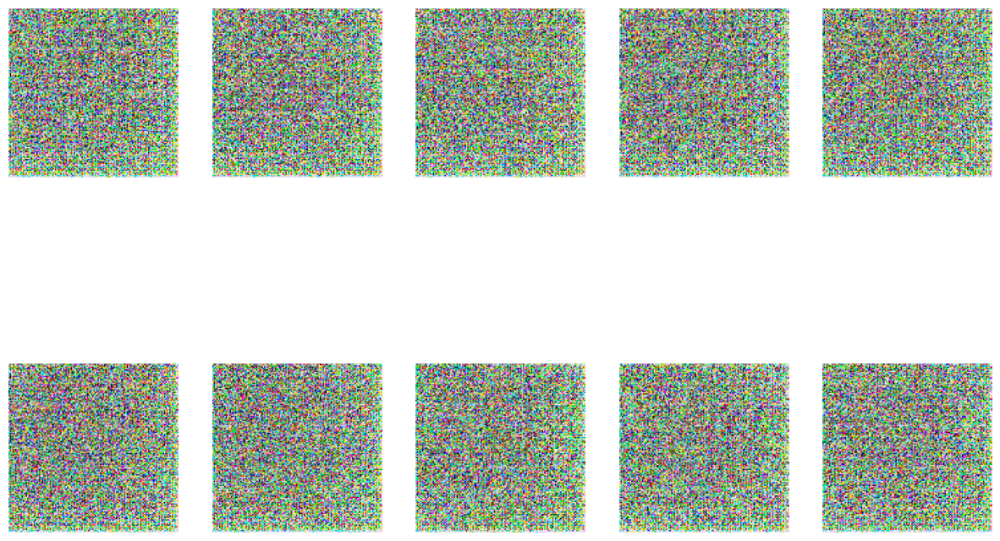

In [13]:
model = torch.load("model990.pt")
images = trainer.generate_images(10)
images  = [images[i].permute(1,2,0).detach().cpu().numpy() for i in range(images.shape[0])]
plt.figure(figsize=(15, 10))  # Adjust the size as needed

# Loop through the images and display each one
for i, image in enumerate(images):
    plt.subplot(2, 5, i + 1)  # Change '1, 5' to the desired grid layout
    plt.imshow((image * 255).astype(np.uint8))
    plt.axis('off')  # This hides the axis

plt.show()